In [71]:
import pandas as pd
import geopandas as gpd
import gpxpy
import folium
from folium.plugins import HeatMap, MarkerCluster
from shapely.geometry import Point


# importing required modules 
from zipfile import ZipFile 

In [5]:
# zipfile = "/media/psf/Home/Documents/GitHub/GPX/ukraine/ukraine-natural-shape.zip"

# # opening the zip file in READ mode 
# with ZipFile(zipfile, 'r') as zip: 
#     # printing all the contents of the zip file 
#     zip.printdir() 
  
#     # extracting all the files 
#     print('Extracting all the files now...') 
#     zip.extractall() 
#     print('Done!') 
    
# fname = "/media/psf/Home/Downloads/hr_1km.shp"
# gdf = gpd.read_file(fname)

# gdf.to_crs("EPSG:4326")

File Name                                             Modified             Size
natural.dbf                                    2009-07-10 05:18:10       206697
natural.prj                                    2009-07-10 05:18:10          144
natural.shp                                    2009-07-10 05:18:10      1762228
natural.shx                                    2009-07-10 05:18:10        21844
A-README.TXT                                   2014-09-04 20:02:26          842
Extracting all the files now...
Done!


In [14]:
gdf_natural = gpd.read_file("/media/psf/Home/Documents/GitHub/GPX/ukraine/natural.shp")
gdf_places = gpd.read_file("/media/psf/Home/Documents/GitHub/GPX/ukraine/places.shp")
gdf_roads = gpd.read_file("/media/psf/Home/Documents/GitHub/GPX/ukraine/roads.shp")
gdf_waterways = gpd.read_file("/media/psf/Home/Documents/GitHub/GPX/ukraine/waterways.shp")

In [32]:
for shape_gdf in [gdf_natural,gdf_places,gdf_roads,gdf_waterways]:
    print  (shape_gdf.shape)

(2718, 4)
(31013, 5)
(22724, 7)
(1011, 5)


set lat, long for Crimea

In [59]:
crimea_lat = 45.3042515
crimea_long = 33.4392582

In [66]:
t_list = ['Stamen Terrain, Stamen Toner, Mapbox Bright']
Terrain = folium.Map(location=[crimea_lat, crimea_long],
                        tiles = "Stamen Terrain", zoom_start=8)
Terrain


In [70]:
t_list = ["Stamen Terrain", "Stamen Toner", "Mapbox Bright"]
Terrain = folium.Map(location=[crimea_lat, crimea_long],
                        tiles = "Stamen Toner", zoom_start=8)
Terrain
to_html(Terrain)

Loop around a Geopandas dataframe and get the lat/long from each row

In [75]:
def add_markers(mapobj, gdf):
    coords = []
    for i, row in gdf.iterrows():
        coords.append([row.geometry.y, row.geometry.x])
    for coord in coords:
        folium.CircleMarker(location = coord,
                            radius = 2.5, 
                            fill = True,
                            fill_color = '#F50057',
                            fill_opacity = 0.75,
                            color = 'whitesmoke',
                            weight = 0.5).add_to(mapobj)
    return mapobj

f = folium.Figure(height = 400)
m = folium.Map([crimea_lat, crimea_long], zoom_start = 15, tiles='Cartodb dark_matter')
m.add_to(f)

add_markers(m, gdf_places)

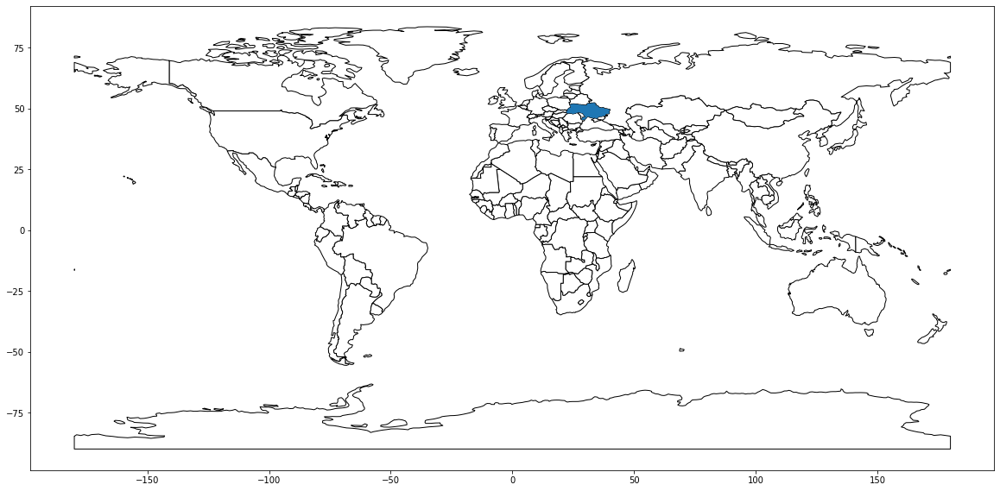

In [185]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
crimea = world[world.name == "Ukraine"]

base = world.plot(figsize=(20,10),color='white', edgecolor='black')
crimea.plot(ax=base)

In [237]:
# create 1 point
pts = gpd.GeoSeries([Point(crimea_long, crimea_lat)])

# change crs projection for both
pts.crs = "EPSG:4326"
gdf_places.to_crs = "ESPG:4326"

# create a buffer around the point
buffer = pts.geometry.buffer(10000)

my_union = buffer.geometry.unary_union

# get the points inside
outside_buffer = gdf_places.loc[~gdf_places["geometry"].apply(lambda x: my_union.contains(x))]

In [238]:
outside_buffer["geometry"]

0        POLYGON ((26123.924 50.450, 26111.879 -440.226...
1        POLYGON ((26124.687 51.500, 26112.641 -439.177...
2        POLYGON ((26124.130 46.471, 26112.084 -444.205...
3        POLYGON ((26129.630 49.990, 26117.585 -440.687...
4        POLYGON ((26117.431 49.842, 26105.386 -440.835...
                               ...                        
31008    POLYGON ((26129.627 50.034, 26117.581 -440.642...
31009    POLYGON ((26129.553 49.985, 26117.508 -440.692...
31010    POLYGON ((26129.604 50.059, 26117.558 -440.617...
31011    POLYGON ((26129.659 50.089, 26117.613 -440.588...
31012    POLYGON ((26124.672 49.487, 26112.626 -441.190...
Name: geometry, Length: 31013, dtype: geometry

In [239]:
def embed_map(m, file_name):
    from IPython.display import IFrame
    m.save(file_name)
    return IFrame(file_name, width='100%', height='500px')

In [240]:
def add_markers(mapobj, gdf):
    heat_data = [[row.geometry.centroid.x,row.geometry.centroid.y] for index, row in gdf.iterrows()]
    HeatMap(data=coords, radius=9).add_to(mapobj)

f = folium.Figure(height = 400)
m = folium.Map([crimea_lat, crimea_long], zoom_start = 8)
m.add_to(f)

add_markers(m, gdf_places)

m

In [207]:
from folium import Choropleth, Marker
from folium.plugins import HeatMap, MarkerCluster


In [215]:
m_2 = folium.Map(location=[crimea_lat,crimea_long], zoom_start=8) 

for idx, row in gdf_places.iterrows():

HeatMap(data=([row.geometry.centroid.x,row.geometry.centroid.y]), radius=9).add_to(m_2)

# Show the map
embed_map(m_2, "q_2.html")

TypeError: 'float' object is not subscriptable

In [227]:
coords=[]
for idx, row in gdf_places.iterrows():
    coords.append([row.geometry.centroid.x,row.geometry.centroid.y])

In [232]:
heat_data = [[row.geometry.centroid.x,row.geometry.centroid.y] for index, row in gdf_places.iterrows()]

In [234]:
heat_data

[[30.59615586638415, 50.45025280000122],
 [31.358767066383642, 51.4997342999979],
 [30.80178616638461, 46.47134670000356],
 [36.30243636638398, 49.990102099998495],
 [24.10348856638343, 49.8418158999983],
 [31.022856766385033, 50.35199809999921],
 [30.535536866382397, 50.56770249999844],
 [27.35679076638177, 51.50497099999959],
 [30.967331166384774, 50.34089420000059],
 [35.59388476638403, 50.16026389999788],
 [34.63521516638327, 49.592003399998084],
 [35.51802406638489, 49.38007420000015],
 [35.182237066386186, 47.86000739999916],
 [30.843414966383136, 50.4995648999944],
 [33.432374466385944, 45.200316399999544],
 [28.677172566383998, 45.69500750000226],
 [30.702235566384196, 50.110063300002736],
 [37.67472576638299, 47.11104860000036],
 [23.488819466384147, 50.16666669999876],
 [30.320087966382143, 50.51942319999721],
 [30.342769566383165, 50.42378630000068],
 [30.43884866638452, 50.38333539999903],
 [30.411180866381585, 50.438593699999714],
 [30.360870766384334, 50.32891460000237],
